# Анимация линейной модели

Визуализация пространств $R^N$ (пространство ответов) и $R^D$ (пространство признаков) с анимацией изменения весов $w$.

/Users/vladmac/Code/ML-Colab/Andrey Karpathy Lessons/.venv/lib/python3.14/site-packages/matplotlib/animation.py:908: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


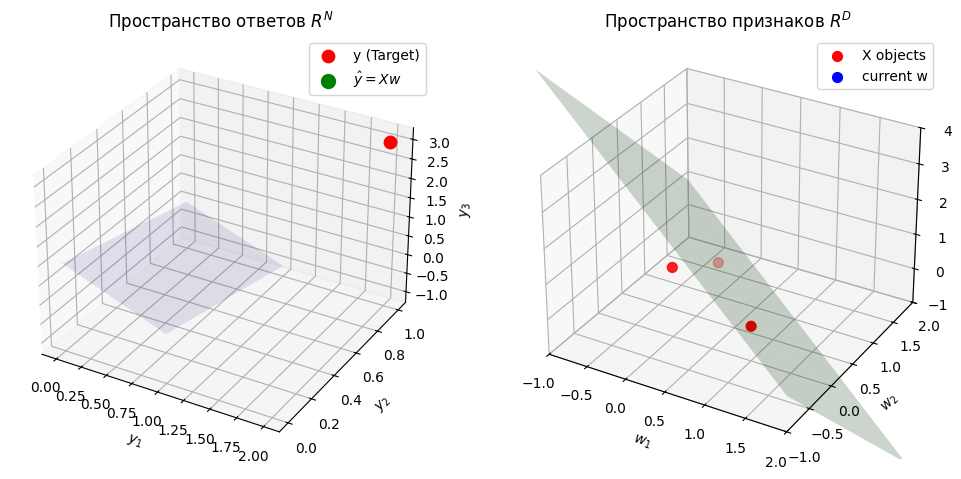

In [17]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# =============================
# Данные
# =============================
# 3 точки (N=3), D=3 для наглядности в R^3
X_vals = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])  # признаки 3 объектов, 3 признака
y_vals = np.array([2.0, 1.0, 3.0])                    # целевые значения

# Ключевые точки w, через которые пройдет анимация
w_key_points = [np.array([0.5, 0.5, 0.5]),
                np.array([0.7, 0.3, 0.6]),
                np.array([1.0, 0.5, 0.2]),
                np.array([1.2, 0.2, 0.8]),
                np.array([0.9, 0.8, 0.4])]

# Генерация промежуточных кадров (интерполяция)
frames_per_transition = 20
w_frames = []
for i in range(len(w_key_points) - 1):
    start_w = w_key_points[i]
    end_w = w_key_points[i+1]
    for alpha in np.linspace(0, 1, frames_per_transition):
        w_frames.append(start_w * (1 - alpha) + end_w * alpha)

# =============================
# Подготовка фигуры
# =============================
fig = plt.figure(figsize=(12, 6))

# --- Левый график: Пространство ответов (R^N) ---
ax1 = fig.add_subplot(121, projection='3d')
ax1.set_title('Пространство ответов $R^N$')
ax1.set_xlabel('$y_1$')
ax1.set_ylabel('$y_2$')
ax1.set_zlabel('$y_3$')

# Плоскость span(X) - в данном случае выпуклая оболочка базисных векторов (для стиля)
u = np.linspace(0, 1, 10)
v = np.linspace(0, 1, 10)
U, V = np.meshgrid(u, v)
plane = np.zeros((10, 10, 3))
for i in range(10):
    for j in range(10):
        plane[i,j] = U[i,j]*X_vals[0] + V[i,j]*X_vals[1] + (1-U[i,j]-V[i,j])*X_vals[2]
ax1.plot_surface(plane[:,:,0], plane[:,:,1], plane[:,:,2], alpha=0.1, color='blue')

# Целевая точка y
ax1.scatter(y_vals[0], y_vals[1], y_vals[2], color='red', s=80, label='y (Target)')

# Динамические элементы для ax1
scat1 = ax1.scatter([], [], [], color='green', s=100, label='$\\hat{y} = Xw$')
line1, = ax1.plot([], [], [], 'k--', alpha=0.6)
text1 = ax1.text2D(0.05, 0.95, "", transform=ax1.transAxes)

ax1.legend()

# --- Правый график: Пространство признаков (R^D) ---
ax2 = fig.add_subplot(122, projection='3d')
ax2.set_title('Пространство признаков $R^D$')
ax2.set_xlabel('$w_1$')
ax2.set_ylabel('$w_2$')
ax2.set_zlabel('$w_3$')

# Объекты (признаки)
ax2.scatter(X_vals[:,0], X_vals[:,1], X_vals[:,2], color='red', s=50, label='X objects')

# Сетка для плоскости
x_range = np.linspace(-1, 2, 10)
y_range = np.linspace(-1, 2, 10)
Xg, Yg = np.meshgrid(x_range, y_range)

# Контейнер для поверхности, чтобы обновлять её
surf_plot = [None]
w_scat = ax2.scatter([], [], [], color='blue', s=50, label='current w')

ax2.legend()

# =============================
# Функция анимации
# =============================
def init():
    scat1._offsets3d = ([], [], [])
    line1.set_data([], [])
    line1.set_3d_properties([])
    text1.set_text('')
    w_scat._offsets3d = ([], [], [])
    return scat1, line1, text1, w_scat

def update(frame):
    w = w_frames[frame]
    
    # 1. Update R^N (Left)
    y_hat = X_vals @ w
    scat1._offsets3d = ([y_hat[0]], [y_hat[1]], [y_hat[2]])
    
    # Линия ошибки
    line1.set_data([y_vals[0], y_hat[0]], [y_vals[1], y_hat[1]])
    line1.set_3d_properties([y_vals[2], y_hat[2]])
    
    # Текст ошибки
    error = np.linalg.norm(y_vals - y_hat)
    text1.set_text(f'Error: {error:.2f}')
    
    # 2. Update R^D (Right)
    # Отображаем текущий w как точку
    w_scat._offsets3d = ([w[0]], [w[1]], [w[2]])
    
    # Обновляем плоскость w^T x = 1 (если w[2] != 0)
    if surf_plot[0]:
        surf_plot[0].remove()
        surf_plot[0] = None
    
    if abs(w[2]) > 0.01:
        Zg = (1 - w[0]*Xg - w[1]*Yg) / w[2]
        # Ограничим Z для красоты графика, чтобы не улетал в бесконечность
        # Но matplotlib сам обрежет по осям, если они фиксированы. 
        # Зафиксируем оси, чтобы график не скакал.
        surf_plot[0] = ax2.plot_surface(Xg, Yg, Zg, alpha=0.2, color='green')
        
    return scat1, line1, text1, w_scat, surf_plot[0]

# Блокируем оси чтобы не скакали при перерисовке
ax2.set_xlim(-1, 2)
ax2.set_ylim(-1, 2)
ax2.set_zlim(-1, 4)

anim = FuncAnimation(fig, update, frames=len(w_frames), init_func=init, interval=50, blit=False)

# Для отображения в Jupyter Notebook
HTML(anim.to_jshtml())

# Линейная регрессия и метод наименьших квадратов (МНК)

В этом разделе мы реализуем основные концепции из статьи [Яндекс.Хендбука](https://education.yandex.ru/handbook/ml/article/linear-models#linejnaya-regressiya-i-metod-naimenshih-kvadratov-mnk):

1.  **Постановка задачи и MSE**
2.  **Аналитическое решение (Normal Equation)**
3.  **Градиентный спуск (Gradient Descent)**
4.  **Стохастический градиентный спуск (SGD)**

## 1. Сведение к задаче оптимизации (MSE)

Мы хотим приблизить зависимость $y$ от $x$ как $y \approx Xw$.
В качестве функции потерь используем **MSE (Mean Squared Error)** - среднеквадратичную ошибку:

$$ Q(w) = \frac{1}{N} ||Xw - y||^2 $$

Сгенерируем простой одномерный датасет вида $y = 4 + 3x + \text{noise}$.

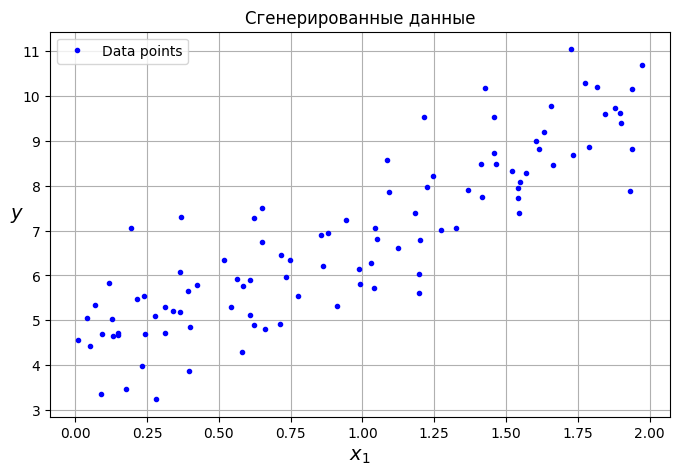

In [18]:
np.random.seed(42)
N = 100
X = 2 * np.random.rand(N, 1)
y = 4 + 3 * X + np.random.randn(N, 1)

# Добавляем x0 = 1 для свободного члена (bias)
X_b = np.c_[np.ones((N, 1)), X]

plt.figure(figsize=(8, 5))
plt.plot(X, y, "b.", label="Data points")
plt.xlabel("$x_1$", fontsize=14)
plt.ylabel("$y$", rotation=0, fontsize=14)
plt.legend()
plt.title("Сгенерированные данные")
plt.grid(True)
plt.show()

## 2. МНК: точный аналитический метод

Точное решение (Normal Equation) находится по формуле:

$$ w = (X^T X)^{-1} X^T y $$

Контекст задачи
Мы ищем оптимальные веса $w$ для линейной модели $\hat{y} = Xw$, минимизируя ошибку $|y - Xw|^2$.

Шаг 1: Ортогональное разложение вектора
Теорема об ортогональном разложении: Любой вектор $y \in \mathbb{R}^N$ можно разложить на две ортогональные компоненты: $$y = y_{|} + y_{\perp}$$

где:

$y_{|}$ — проекция $y$ на подпространство $\text{span}(X)$ (пространство столбцов матрицы $X$)
$y_{\perp}$ — ортогональная составляющая к этому подпространству
Ключевое свойство: $y_{|} \perp y_{\perp}$, то есть $\langle y_{|}, y_{\perp} \rangle = 0$

Шаг 2: Что такое проекция?
Определение проекции: $$y_{|} = Xw$$

Это наилучшее приближение $y$ в подпространстве $\text{span}(X)$.

Ортогональная составляющая: $$y_{\perp} = y - Xw$$

Эта составляющая ортогональна каждому столбцу матрицы $X$, то есть: $$y_{\perp} \perp x^{(1)}, \ldots, y_{\perp} \perp x^{(D)}$$

Шаг 3: Условие ортогональности в матричной форме
Что означает "ортогональна всем столбцам"?

Если вектор $y_{\perp}$ ортогонален каждому столбцу $x^{(i)}$, то: $$\langle y_{\perp}, x^{(i)} \rangle = 0, \quad \forall i = 1, \ldots, D$$

Матричная запись: Скалярное произведение вектора на все столбцы матрицы $X$ можно записать как: $$X^T y_{\perp} = \begin{pmatrix} \langle x^{(1)}, y_{\perp} \rangle \ \langle x^{(2)}, y_{\perp} \rangle \ \vdots \ \langle x^{(D)}, y_{\perp} \rangle \end{pmatrix} = \begin{pmatrix} 0 \ 0 \ \vdots \ 0 \end{pmatrix} = \mathbf{0}$$

Свойство транспонирования: $$X^T y_{\perp} = X^T(y - Xw) = \mathbf{0}$$

Это и есть условие нормальных уравнений (Normal Equations).

Шаг 4: Вывод формулы для $w$
Раскроем уравнение $X^T(y - Xw) = \mathbf{0}$:

Шаг 4.1: Дистрибутивность матричного умножения $$X^T y - X^T X w = \mathbf{0}$$

Аксиома: $(AB)C = A(BC)$ — ассоциативность матричного умножения.

Шаг 4.2: Перенос слагаемого $$X^T X w = X^T y$$

Шаг 4.3: Умножение на обратную матрицу

Если матрица $X^T X$ обратима (это требует, чтобы столбцы $X$ были линейно независимы), то существует $(X^T X)^{-1}$.

Свойство обратной матрицы: $$A^{-1} A = I \quad \text{(единичная матрица)}$$

Умножим обе части слева на $(X^T X)^{-1}$: $$(X^T X)^{-1} X^T X w = (X^T X)^{-1} X^T y$$

Упрощение: $$I \cdot w = (X^T X)^{-1} X^T y$$

$$\boxed{w = (X^T X)^{-1} X^T y}$$

Использованные аксиомы и свойства
1. Ортогональность
Определение: $u \perp v \iff \langle u, v \rangle = 0$
Свойство: Если $u \perp v$, то $|u + v|^2 = |u|^2 + |v|^2$ (теорема Пифагора)
2. Проекция на подпространство
Проекция $y$ на $\text{span}(X)$ — это вектор $y_{|} = Xw$, минимизирующий $|y - Xw|^2$
Ошибка проекции $y_{\perp} = y - y_{|}$ ортогональна подпространству
3. Транспонирование матрицы
$(AB)^T = B^T A^T$
$\langle Ax, y \rangle = \langle x, A^T y \rangle$ (свойство сопряженного оператора)
4. Матричное умножение
Ассоциативность: $(AB)C = A(BC)$
Дистрибутивность: $A(B + C) = AB + AC$
5. Обратная матрица
Существует, если $\det(X^T X) \neq 0$ (столбцы $X$ линейно независимы)
$A^{-1} A = A A^{-1} = I$
6. Нормальные уравнения
$X^T(y - Xw) = 0$ — геометрическое условие: остаток ортогонален всем признакам
Геометрическая интерпретация
Подпространство $\text{span}(X)$ — это все возможные линейные комбинации столбцов $X$
Проекция $y_{|} = Xw$ — ближайшая точка в этом подпространстве к $y$
Ортогональность — вектор ошибки $y - Xw$ перпендикулярен подпространству
Минимизация — это единственная точка, где градиент функции потерь $|y - Xw|^2$ равен нулю
Почему это работает?

Это решение единственное (при условии обратимости $X^T X$) и оптимальное в смысле минимизации квадратичной ошибки: $$\min_w |y - Xw|^2$$

Это называется метод наименьших квадратов (Ordinary Least Squares, OLS).

Лучшие веса (Аналитическое решение):
w0 (bias) = 4.2151
w1 (slope) = 2.7701
Ожидаемые: w0=4, w1=3


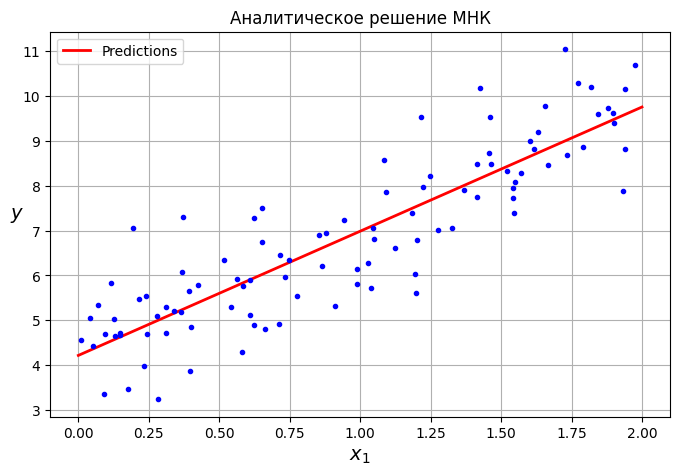

In [ ]:
# Вычисление точного решения с помощью обратной матрицы
# w_best = (X^T * X)^(-1) * X^T * y
w_best = np.linalg.inv(X_b.T @ X_b) @ X_b.T @ y

print("Лучшие веса (Аналитическое решение):")
print(f"w0 (bias) = {w_best[0][0]:.4f}")
print(f"w1 (slope) = {w_best[1][0]:.4f}")
print(f"Ожидаемые: w0=4, w1=3")

# Визуализация
X_new = np.array([[0], [2]])
X_new_b = np.c_[np.ones((2, 1)), X_new]
y_predict = X_new_b @ w_best

plt.figure(figsize=(8, 5))
plt.plot(X_new, y_predict, "r-", linewidth=2, label="Predictions")
plt.plot(X, y, "b.")
plt.xlabel("$x_1$", fontsize=14)
plt.ylabel("$y$", rotation=0, fontsize=14)
plt.legend(loc="upper left")
plt.title("Аналитическое решение МНК")
plt.grid(True)
plt.show()

## 3. МНК: приближенный численный метод (Gradient Descent)

Итеративное обновление весов в направлении антиградиента:

$$ \nabla_w Q(w) = \frac{2}{N} X^T (Xw - y) $$
$$ w_{next} = w - \alpha \nabla_w Q(w) $$

In [ ]:
eta = 0.1  # learning rate (темп обучения)
n_iterations = 1000
m = N  # количество образцов
w = np.random.randn(2, 1)  # случайная инициализация

loss_history = []

for iteration in range(n_iterations):
    gradients = 2/m * X_b.T @ (X_b @ w - y)
    w = w - eta * gradients
    
    # Считаем MSE для графиков
    loss = np.mean((X_b @ w - y)**2)
    loss_history.append(loss)

print("Веса после Градиентного спуска:")
print(f"w0 = {w[0][0]:.4f}, w1 = {w[1][0]:.4f}")

plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(loss_history)
plt.title("График падения ошибки (Loss)")
plt.xlabel("Итерации")
plt.ylabel("MSE")

plt.subplot(1, 2, 2)
plt.plot(X_new, X_new_b @ w, "g-", linewidth=2, label="GD Prediction")
plt.plot(X, y, "b.")
plt.title("Градиентный спуск")
plt.legend()
plt.show()

## 4. Стохастический градиентный спуск (SGD)

Вместо вычисления градиента по всей выборке, считаем его по *мини-батчам* (небольшим подвыборкам).
Это работает быстрее на больших данных и помогает избегать локальных минимумов для более сложных функций.

In [ ]:
n_epochs = 50
t0, t1 = 5, 50  # параметры learning schedule
batch_size = 20

def learning_schedule(t):
    return t0 / (t + t1)

w = np.random.randn(2, 1)
loss_history_sgd = []

for epoch in range(n_epochs):
    shuffled_indices = np.random.permutation(m)
    X_b_shuffled = X_b[shuffled_indices]
    y_shuffled = y[shuffled_indices]
    
    for i in range(0, m, batch_size):
        xi = X_b_shuffled[i:i+batch_size]
        yi = y_shuffled[i:i+batch_size]
        
        gradients = 2/len(xi) * xi.T @ (xi @ w - yi)
        eta = learning_schedule(epoch * m + i)
        w = w - eta * gradients
        
        loss = np.mean((X_b @ w - y)**2) # MSE на всей выборке (для мониторинга)
        loss_history_sgd.append(loss)

print("Веса после SGD:")
print(f"w0 = {w[0][0]:.4f}, w1 = {w[1][0]:.4f}")

plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(loss_history_sgd, alpha=0.5)
plt.title("График ошибки SGD (шумный)")
plt.xlabel("Шаги обновлений (Steps)")
plt.ylabel("MSE")

plt.subplot(1, 2, 2)
plt.plot(X_new, X_new_b @ w, "m-", linewidth=2, label="SGD Prediction")
plt.plot(X, y, "b.")
plt.title("Стохастический градиентный спуск")
plt.legend()
plt.show()